# Explorer le résultat de la requête (corpus extrait)
Comparaison avec le fichier (README)

## Imports

In [2]:
# Imports

import collections
import os
import re
import string
import sys
from collections import Counter
from pprint import pprint
from collections import defaultdict
import spacy
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
import nltk
import pandas as pd
import yake
from nltk import word_tokenize
from wordcloud import WordCloud
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from IPython.display import Image
from IPython.display import display
import collections
import string
import sys
from pprint import pprint
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from nltk.corpus import stopwords
from scipy.spatial.distance import cosine
from sklearn.decomposition import PCA
import pickle
import sys
import pickle
import nltk
from gensim.models import Word2Vec
from gensim.models.phrases import Phraser, Phrases
from nltk.tokenize import wordpunct_tokenize
from unidecode import unidecode

# Config

txt_path = '../tp4/camille_Dette_Belge_AND_bons_du_tresor_OR_bons_du_tresor/'

temp_path = '../tp4/tmp/'
if not os.path.exists(temp_path):
    os.mkdir(temp_path)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\elaur\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Compter le nombre de documents dans le corpus

In [4]:
path = "../tp4/camille_Dette_Belge_AND_bons_du_tresor_OR_bons_du_tresor/"
files = sorted(os.listdir(path))
len(files)

265

## Statistiques du corpus exploré

In [6]:
all_years = [str(year) for year in range(1830, 1970)]

In [8]:
count_decade = defaultdict(int)
count_month = defaultdict(int)
count_newspapers = defaultdict(int)
covered_years = set()

for f in files:
    if "_" in f and f.endswith("txt"):
        elems = f.split("_")
        
        newspaper = elems[1]
        
        year = elems[2].split("-")[0]
        covered_years.add(year)
        decade = year[:3] + "0s"
        
        month = int(elems[2].split("-")[1])
        
        count_decade[decade] += 1
        count_newspapers[newspaper] += 1
        count_month[month] += 1
    else:
        print(f"Anomalous file: {f}")

In [17]:
print(f"Il y a {count_newspapers['JB729']} exemplaires du journal Le Vingtième Siècle et {count_newspapers['JB555']} exemplaires de L'Indépendance belge")
print(f"Il y a {count_newspapers['JB555A']} exemplaires du journal L'Indépendance belge (édité en Angleterre) et {count_newspapers['JB638']} exemplaires de La meuse")

Il y a 21 exemplaires du journal Le Vingtième Siècle et 60 exemplaires de L'Indépendance belge
Il y a 0 exemplaires du journal L'Indépendance belge (édité en Angleterre) et 37 exemplaires de La meuse


In [34]:
print(f"Il y a {count_decade['1840s']} fichiers pour la décennie 1840s")
print(f"Il y a {count_decade['1900s']} fichiers pour la décennie 1900s")

Il y a 2 fichiers pour la décennie 1840s
Il y a 14 fichiers pour la décennie 1900s


In [36]:
missing_years = [y for y in all_years if y not in covered_years]
print(f"Années manquantes: {', '.join(missing_years)}")

Années manquantes: 1830, 1831, 1832, 1833, 1834, 1835, 1836, 1837, 1838, 1839, 1841, 1842, 1843, 1844, 1845, 1846, 1847, 1849, 1850, 1853, 1854, 1855, 1856, 1857, 1858, 1859, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1871, 1872, 1874, 1876, 1877, 1880, 1881, 1882, 1883, 1884, 1885, 1886, 1887, 1888, 1889, 1891, 1894, 1895, 1896, 1897, 1898, 1902, 1904, 1905, 1906, 1915, 1916, 1917, 1920, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969


## Visualisation du nombre de journaux par mois
Visualisation avec la librairie Matplotlib.

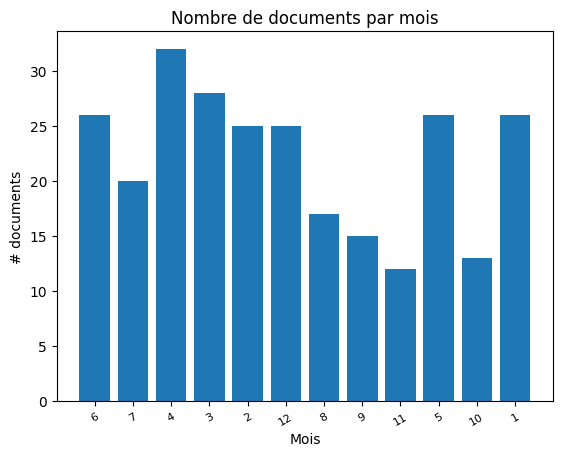

In [37]:
index = np.arange(len(count_month))
plt.bar(index, count_month.values())
plt.xlabel('Mois')
plt.ylabel('# documents')
plt.xticks(index, count_month.keys(), fontsize=8, rotation=30)
plt.title('Nombre de documents par mois')
plt.show()

# Extraction de Mots cles
Extraire les mots clés du document avec Yake

https://github.com/LIAAD/yake

In [40]:
# Instantier l'extracteur de mots clés
kw_extractor = yake.KeywordExtractor(lan="fr", top=50)
kw_extractor

In [42]:
# Les fichiers
files[:265]

['KB_JB1051_1925-06-03_01-00001.txt',
 'KB_JB1051_1925-07-08_01-00002.txt',
 'KB_JB1051_1926-04-03_01-00002.txt',
 'KB_JB421_1921-03-16_01-00003.txt',
 'KB_JB421_1923-02-14_01-00003.txt',
 'KB_JB421_1925-12-18_01-00002.txt',
 'KB_JB421_1926-08-08_01-00004.txt',
 'KB_JB421_1932-09-24_01-00003.txt',
 'KB_JB421_1932-11-09_01-00003.txt',
 'KB_JB421_1935-05-14_01-00001.txt',
 'KB_JB421_1937-05-14_01-00002.txt',
 'KB_JB427_1919-06-07_01-00002.txt',
 'KB_JB427_1921-05-20_01-00002.txt',
 'KB_JB427_1925-06-20_01-00002.txt',
 'KB_JB427_1925-08-26_01-00003.txt',
 'KB_JB427_1926-07-17_01-00003.txt',
 'KB_JB427_1926-08-09_01-00006.txt',
 'KB_JB427_1926-08-23_01-00006.txt',
 'KB_JB427_1927-09-23_01-00001.txt',
 'KB_JB427_1929-02-17_01-00001.txt',
 'KB_JB427_1935-05-12_01-00001.txt',
 'KB_JB427_1935-05-12_01-00002.txt',
 'KB_JB427_1935-05-13_01-00001.txt',
 'KB_JB427_1935-05-14_01-00002.txt',
 'KB_JB427_1936-10-21_01-00002.txt',
 'KB_JB555_1840-06-05_01-00001.txt',
 'KB_JB555_1848-04-12_01-00006.txt'

In [71]:
# Choisir un fichier
this_file = files [197]
this_file

'KB_JB837_1932-12-07_01-00002.txt'

In [72]:
# Récupérer le texte du fichier
text = open(os.path.join(path, this_file),'r', encoding="utf-8").read()
text[:500]

"V M SAINTE-BARBE EN AUVERGNE (Voir commencement en t** page.) J'interroge les miUtants de la O G T sur la crise Combien de chômeurs? «Oh' pas beaucoup. 700 environ Mals la population de la ville a diminué. La maison Miche. in jccupait 17.000 ouvriers Elle en a licencié 7.000 » Je m'étonne et l'interroge. Quoi? Ces 7.000 travailleurs, licenciés, ne sont-Us pas considérés comme chômeurs? Pas du tout. Ces hommes étaient venus des campagnes proches ou des autobus allaient les prendre tous les matins"

In [73]:
# Extraire les mots clés de ce texte
keywords = kw_extractor.extract_keywords(text)
keywords

[('Bruxelles', 0.00797101109338981),
 ('heures', 0.011814113993735803),
 ('SAINTE-BARBE EN AUVERGNE', 0.014346780213914),
 ('salle', 0.014976725803420509),
 ('décembre', 0.015361639896713134),
 ('Conseil', 0.026006873394129278),
 ('cours', 0.027462031105099552),
 ('jours', 0.028011464962273053),
 ('artistes', 0.028419019689221784),
 ("qu'il", 0.029958645323790965),
 ('socialiste', 0.03043040761571868),
 ('parti libéral', 0.03149893265120696),
 ('Jour', 0.03201310281402635),
 ('Comité', 0.032321923524875555),
 ('soir', 0.03285309308873323),
 ('maison', 0.034671896122064616),
 ('Belgique', 0.03494758159341479),
 ('Liège', 0.03684454617932966),
 ('mardi', 0.037022196395214944),
 ('parti', 0.03779911715560144),
 ('Claire Collet', 0.039470223804608726),
 ('temps', 0.03970795727544541),
 ('cinéma', 0.04386801663517892),
 ('semaine', 0.043936707684866794),
 ('liste socialiste', 0.045354011253497174),
 ('élèves', 0.046873179031364225),
 ('matin', 0.047673015424275815),
 ('pays', 0.050515730550

In [74]:
# Ne garder que les bigrammes
# Regarder si la liste contient 2 elements
kept = []
for kw, score in keywords:
    words = kw.split()
    if len(words) == 2:
        kept.append(kw)
kept

['parti libéral',
 'Claire Collet',
 'liste socialiste',
 'Roger Liévin',
 'Comité général']

## Faire la même opération sur tous les documents

In [76]:
#Pour tous les elements quels sonts les mots cles
for f in sorted(files)[0:10]:
    text = open(os.path.join(path, f), 'r', encoding="utf-8").read()
    keywords = kw_extractor.extract_keywords(text)
    kept = []
    for kw, score in keywords:
        words = kw.split()
        if len(words) == 2:
            kept.append(kw)
    print(f"{f} mentions these keywords: {', '.join(kept)}...")

KB_JB1051_1925-06-03_01-00001.txt mentions these keywords: DEUXIEME ANNEE, Conseil général, plan Dawes, dettes belges, dette belge, parti catholique, soi-disant socialiste...
KB_JB1051_1925-07-08_01-00002.txt mentions these keywords: classe ouvrière, millions d'impôts, DRAPEAU ROUGB, Journée Coopérative, dettes qu'ils, DETTE BELGE, ouvrier belge, QU'ILS EXIGENT...
KB_JB1051_1926-04-03_01-00002.txt mentions these keywords: VOIR DEBUT, l'KEMIERE l'AGl, LONGUEURS D'ONDES, films qu'il, films comiques, bon état...
KB_JB421_1921-03-16_01-00003.txt mentions these keywords: Ports Atl, grand match, lundi soir...
KB_JB421_1923-02-14_01-00003.txt mentions these keywords: lieutenant Van, Bulletin météorologique, lord Carnarvon, TEMPS QUIL, dit registre, nouveau registre, lieutenant Willems, major Louvau, lieutenant Pelre...
KB_JB421_1925-12-18_01-00002.txt mentions these keywords: l'Etat Libre, Libre d'Irlande, gouvernement britannique, Tchang Tso, c'est qu'il, nouveaux impôts, qu'il faut, Tso Lin

# Conversion des fichiers en corpus

## Imports

In [77]:
import os
import textract

## Créer le 'corpus' (Grand fichier text resultant du concatenage des fichiers texts)

In [79]:
# Lister les Fichiers
data_path = "../tp4/camille_Dette_Belge_AND_bons_du_tresor_OR_bons_du_tresor/"
files = os.listdir(data_path)
files

['KB_JB1051_1925-06-03_01-00001.txt',
 'KB_JB1051_1925-07-08_01-00002.txt',
 'KB_JB1051_1926-04-03_01-00002.txt',
 'KB_JB421_1921-03-16_01-00003.txt',
 'KB_JB421_1923-02-14_01-00003.txt',
 'KB_JB421_1925-12-18_01-00002.txt',
 'KB_JB421_1926-08-08_01-00004.txt',
 'KB_JB421_1932-09-24_01-00003.txt',
 'KB_JB421_1932-11-09_01-00003.txt',
 'KB_JB421_1935-05-14_01-00001.txt',
 'KB_JB421_1937-05-14_01-00002.txt',
 'KB_JB427_1919-06-07_01-00002.txt',
 'KB_JB427_1921-05-20_01-00002.txt',
 'KB_JB427_1925-06-20_01-00002.txt',
 'KB_JB427_1925-08-26_01-00003.txt',
 'KB_JB427_1926-07-17_01-00003.txt',
 'KB_JB427_1926-08-09_01-00006.txt',
 'KB_JB427_1926-08-23_01-00006.txt',
 'KB_JB427_1927-09-23_01-00001.txt',
 'KB_JB427_1929-02-17_01-00001.txt',
 'KB_JB427_1935-05-12_01-00001.txt',
 'KB_JB427_1935-05-12_01-00002.txt',
 'KB_JB427_1935-05-13_01-00001.txt',
 'KB_JB427_1935-05-14_01-00002.txt',
 'KB_JB427_1936-10-21_01-00002.txt',
 'KB_JB555_1840-06-05_01-00001.txt',
 'KB_JB555_1848-04-12_01-00006.txt'

In [80]:
# Imprimer le nombre de fichiers identifiés
len(files)

265

In [81]:
with open("../tp4/corpus.txt", "w", encoding="utf-8") as output_file:
    for file in os.listdir(data_path):
        if file.endswith(".txt"):
            with open(os.path.join(data_path, file), "r", encoding="utf-8") as f:
                output_file.write(f.read())

# Tokeniser
Compter le nombre de mots dans l'ensemble du corpus

In [82]:
# Récupération du contenu du fichier
path = "../tp4/corpus.txt"
limit = 10**9

with open((path),"r", encoding="utf-8") as f:
    text = f.read()[:limit]

In [83]:
# Tokenization
words = nltk.wordpunct_tokenize(text)
print(f"{len(words)} words found")

2730290 words found


In [84]:
# Ensemble de 20 mots
words[:12]

['DEUXIEME',
 'ANNEE',
 '.',
 '-',
 'N',
 '.',
 '130',
 '.',
 '20',
 'centimes',
 'le',
 'numéro']

# Analyse de la distribution du vocabulaire

## Imports et dépendances

In [85]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\elaur\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Créer une une liste de stopwords

In [88]:
sw = stopwords.words("french")
sw += ["les", "plus", "cette", "fait", "faire", "être", "deux", "comme", "dont", "tout", 
       "ils", "bien", "sans", "peut", "tous", "après", "ainsi", "donc", "cet", "sous",
       "celle", "entre", "encore", "toutes", "pendant", "moins", "dire", "cela", "non",
       "faut", "trois", "aussi", "dit", "avoir", "doit", "contre", "depuis", "autres",
       "van", "het", "autre", "jusqu",'ai', 'aie', 'aient', 'aies', 'ainsi', 'ait', 'après',
        'as', 'au', 'aura', 'aurai', 'auraient', 'aurais', 'aurait', 'auras', 'aurez', 'auriez',
         'aurions', 'aurons', 'auront', 'aussi', 'autre', 'autres', 'aux', 'avaient', 'avais',
          'avait', 'avec', 'avez', 'aviez', 'avions', 'avoir', 'avons', 'ayant', 'ayante',
           'ayantes', 'ayants', 'ayez', 'ayons', 'bien', 'c', 'ce', 'cela', 'celle', 'ces',
            'cet', 'cette', 'comme', 'contre', 'd', 'dans', 'de', 'depuis', 'des', 'deux',
             'dire', 'dit', 'doit', 'donc', 'dont', 'du', 'elle', 'en', 'encore', 'entre',
              'es', 'est', 'et', 'eu', 'eue', 'eues', 'eurent', 'eus', 'eusse', 'eussent', 'eusses',
               'eussiez', 'eussions', 'eut', 'eux', 'eûmes', 'eût', 'eûtes', 'faire', 'fait', 'faut',
                'furent', 'fus', 'fusse', 'fussent', 'fusses', 'fussiez', 'fussions', 'fut', 'fûmes',
                 'fût', 'fûtes', 'het', 'il', 'ils', 'j', 'je', 'jusqu', 'l', 'la', 'le', 'les', 'leur',
                  'lui', 'm', 'ma', 'mais', 'me', 'mes', 'moi', 'moins', 'mon', 'même', 'n', 'ne', 'non',
                   'nos', 'notre', 'nous', 'on', 'ont', 'ou', 'par', 'pas', 'pendant', 'peut', 'plus',
                    'pour', 'qu', 'que', 'qui', 's', 'sa', 'sans', 'se', 'sera', 'serai', 'seraient',
                     'serais', 'serait', 'seras', 'serez', 'seriez', 'serions', 'serons', 'seront',
                      'ses', 'soient', 'sois', 'soit', 'sommes', 'son', 'sont', 'sous', 'soyez', 'soyons',
                       'suis', 'sur', 't', 'ta', 'te', 'tes', 'toi', 'ton', 'tous', 'tout', 'toutes', 'trois',
                        'tu', 'un', 'une', 'van', 'vos', 'votre', 'vous', 'y', 'à', 'étaient', 'étais', 'était',
                         'étant', 'étante', 'étantes', 'étants', 'étiez', 'étions', 'été', 'étée', 'étées', 'étés',
                          'êtes', 'être']
sw = set(sw)

In [89]:
print(f"{len(sw)} stopwords:\n {sorted(sw)}")

197 stopwords:
 ['ai', 'aie', 'aient', 'aies', 'ainsi', 'ait', 'après', 'as', 'au', 'aura', 'aurai', 'auraient', 'aurais', 'aurait', 'auras', 'aurez', 'auriez', 'aurions', 'aurons', 'auront', 'aussi', 'autre', 'autres', 'aux', 'avaient', 'avais', 'avait', 'avec', 'avez', 'aviez', 'avions', 'avoir', 'avons', 'ayant', 'ayante', 'ayantes', 'ayants', 'ayez', 'ayons', 'bien', 'c', 'ce', 'cela', 'celle', 'ces', 'cet', 'cette', 'comme', 'contre', 'd', 'dans', 'de', 'depuis', 'des', 'deux', 'dire', 'dit', 'doit', 'donc', 'dont', 'du', 'elle', 'en', 'encore', 'entre', 'es', 'est', 'et', 'eu', 'eue', 'eues', 'eurent', 'eus', 'eusse', 'eussent', 'eusses', 'eussiez', 'eussions', 'eut', 'eux', 'eûmes', 'eût', 'eûtes', 'faire', 'fait', 'faut', 'furent', 'fus', 'fusse', 'fussent', 'fusses', 'fussiez', 'fussions', 'fut', 'fûmes', 'fût', 'fûtes', 'het', 'il', 'ils', 'j', 'je', 'jusqu', 'l', 'la', 'le', 'les', 'leur', 'lui', 'm', 'ma', 'mais', 'me', 'mes', 'moi', 'moins', 'mon', 'même', 'n', 'ne', 'non'

## Calculer la taille du vocabulaire

In [90]:
# Eliminer les stopwords et les termes non alphabétiques
kept = [w.lower() for w in words if len(w) > 2 and w.isalpha() and w.lower() not in sw]
voc = set(kept)
print(f"{len(kept)} words kept ({len(voc)} different word forms)")

864917 words kept (124308 different word forms)


## Récupérer les mots les plus fréquents et en faire un plot

In [91]:
fdist = nltk.FreqDist(kept)
fdist.most_common(10)

[('cap', 3321),
 ('francs', 2588),
 ('bruxelles', 2444),
 ('belge', 2276),
 ('cours', 2115),
 ('congo', 1858),
 ('ord', 1838),
 ('disp', 1837),
 ('prix', 1828),
 ('anvers', 1797)]

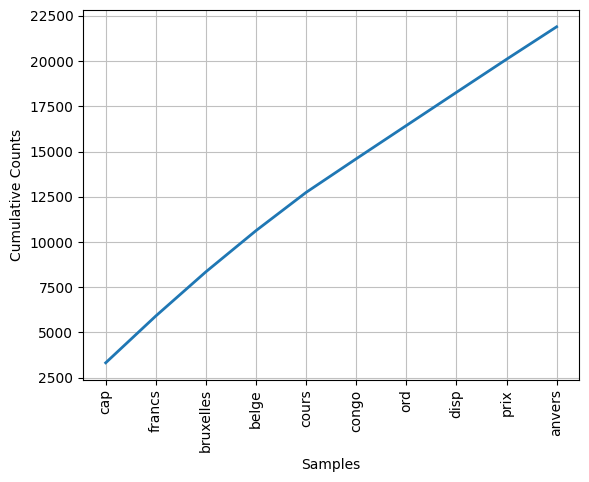

<AxesSubplot: xlabel='Samples', ylabel='Cumulative Counts'>

In [92]:
# Plot: les n mots les plus fréquents
n = 10
fdist.plot(n, cumulative=True)

## Détecter les Hapax (mots qui n'apparaissent qu'une fois dans le corpus)

In [94]:
fdist.hapaxes()[:100]

['liflercrfcdi',
 'drapouge',
 'bruxelleô',
 'beïge',
 'eaens',
 'œllel',
 'trustera',
 'ageuts',
 'peuveut',
 'désorganiserait',
 'ïringoler',
 'troublerait',
 'drainé',
 'bénéficos',
 'detti',
 'goûv',
 'jrtm',
 'piëî',
 'beîtfb',
 'réclamerait',
 'iallut',
 'vcuicut',
 'prêtée',
 'lappelons',
 'ftats',
 'lucra',
 'wmment',
 'naiices',
 'qcin',
 'vessaires',
 'dispensables',
 'inextricable',
 'uiiluenee',
 'tielle',
 'créeront',
 'souscriront',
 'cqntrûle',
 'nsfert',
 'nçe',
 'owté',
 'ricaine',
 'colonisai',
 'réalieé',
 'soeiad',
 'démooratie',
 'asservies',
 'tncossa',
 'défenso',
 'nsw',
 'mtuido',
 'ivlj',
 'marehie',
 'mic',
 'ccoliflge',
 'olidgo',
 'inspirateur',
 'hanrvcy',
 'rétuu',
 'marco',
 'friad',
 'dgssier',
 'tsankoff',
 'friedminn',
 'cathéiralç',
 'exéeu',
 'eoniment',
 'dépeignent',
 'pendaison',
 'pressaienf',
 'gibets',
 'lgorslri',
 'baissaient',
 'mour',
 'sacristain',
 'feula',
 'tzigan',
 'eondant',
 'gibet',
 'kcaff',
 'cagoule',
 'intemationaj',
 'inscrir

## Trouver les mots les plus longs du corpus

In [33]:
n = 30
sorted(voc, key=len, reverse=True)[:n]

['lililtiiiiiiiiiiiiiiiiiiiiiiiiiiiiimilllllllllllllllllllllllllllllllllllllllllllllllllllmiiiiiiiiiiimiiiiiiiiiiiiiiiililllllllllh',
 'illlllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllliilllllllllll',
 'iiitiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiijiii',
 'inlmiiiiiiiiiiiimiiiiiiiiiiiiiimiiiimiiiiillllllllmiiiiiiiiiiiiiiiiiiiiiiiiiiiiimiiimillllhiiiimiiimitlillllllllllll',
 'llltliliiiiilllllllmiiiilitiimliillhîlllllhnillullllllllllmlllllililimmiiiiiiiiiiilliiiiiiililllfl',
 'iiuhiiiiiiiimiiiiiiimihiihiiiiiiiiiiiiiiiiiiiiiiiiuiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiihiii',
 'iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiimiiiiiiiiiiiiiiiiiimcimiiiiiiiiiiiiiiu',
 'illllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllllll',
 'iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiihiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii',
 'staiiiiiimiiiiiiiiiiiiini

# Nuages de mots

## Créer un fichier contenant le texte de tous les journaux d'une année donnée

In [148]:
# Choisir une année
year = 1840

In [149]:
# Lister les fichiers de cette année
data_path = '../tp4'
txt_path = '../tp4/camille_Dette_Belge_AND_bons_du_tresor_OR_bons_du_tresor'
txts = [f for f in os.listdir(txt_path) if os.path.isfile(os.path.join(txt_path, f)) and str(year) in f]
txts

['KB_JB555_1840-06-05_01-00001.txt']

In [150]:
# Stocker le contenu de ces fichiers dans une liste
content_list = []
for txt in txts:
    with open(os.path.join(txt_path, txt), 'r',encoding="utf-8") as f:
        content_list.append(f.read())

In [151]:
# Compter le nombre d'éléments (=fichiers) dans la liste
len(content_list)

1

In [152]:
# Imprimer les 200 premiers caractères du contenu du premier fichier
# A partir de l'element zero
content_list[0][0:200]

"msm Vendredi PH2X DE L'ABONNEMENT FAr trimestre. Pour Bruxelles, fr* 15* Pour laprc » incei II { 7. Pjur l'étranger, 9 20» IJiSERTIOt-TS. 25 centimes par ligne. » iV. 15* -- iO ne Asuiée. ■.I'.'. I ËP"

In [153]:
# Ecrire tout le contenu dans un fichier temporaire
# dans lequel qui contiendra tout le contenu de l'année en question
temp_path = '../tp4/tmp'
if not os.path.exists(temp_path):
    os.mkdir(temp_path)
with open(os.path.join(temp_path, f'{year}.txt'), 'w', encoding="utf-8") as f:
    f.write(' '.join(content_list))

In [154]:
# Imprimer le contenu du fichier et constater les "déchets"
with open(os.path.join(temp_path, f'{year}.txt'), 'r', encoding="utf-8") as f:
    before = f.read()

before[:500]

"msm Vendredi PH2X DE L'ABONNEMENT FAr trimestre. Pour Bruxelles, fr* 15* Pour laprc » incei II { 7. Pjur l'étranger, 9 20» IJiSERTIOt-TS. 25 centimes par ligne. » iV. 15* -- iO ne Asuiée. ■.I'.'. I ËPEMDA' ÉDITION DU MATIN. * bruxeïl<-r au. bw- tagne du rare , n 1 ' 7 , Et chex tous les libraires et martres da 'LIBERTÉ , OUDRE PUBLIC. postes du royaume. BP.UXEIÏ.E5 , le 5 juin. L'attention de la Chambre , évidemment fatiguée d'une discussion qui dure depuis trois jours et où trop de matières à l"

## Nettoyer le fichier à l'aide d'une fonction de nettoyage

### Créer la fonction de nettoyage (à adapter)

In [155]:
#garder tous les mots s'ils sont plus grands que 2 lettre et alphabetique

def clean_text(year, folder=None):
    if folder is None:
        input_path = f"{year}.txt"
        output_path = f"{year}_clean.txt"
    else:
        input_path = f"{folder}/{year}.txt"
        output_path = f"{folder}/{year}_clean.txt"
    output = open(output_path, "w", encoding='utf-8')
    with open(input_path, encoding='utf-8') as f:
        text = f.read()
        words = nltk.wordpunct_tokenize(text)
        kept = [w.lower() for w in words if len(w) > 2 and w.isalpha() and w.lower() not in sw]
        kept_string = " ".join(kept)
        output.write(kept_string)
    return f'Output has been written in {output_path}!'

### Appliquer la fonction sur le fichier complet de l'année

In [156]:
clean_text(year, folder=temp_path)

'Output has been written in ../tp4/tmp/1840_clean.txt!'

In [157]:
# Vérifier le résultat
with open(os.path.join(temp_path, f'{year}_clean.txt'), 'r', encoding="utf-8") as f:
    after = f.read()

after[:500]

'msm vendredi abonnement far trimestre bruxelles laprc incei pjur étranger ijisertiot centimes ligne asuiée ëpemda édition matin bruxeïl tagne rare chex libraires martres liberté oudre public postes royaume uxeiï juin attention chambre évidemment fatiguée discussion dure jours trop matières fois traitées jeté certaine confusion esprits ranimée hier excellent discours meeus honorable député bruxelles renfermé observations question principale situation financière pays mode suivre arriver conclusion'

## Nuage de mots affiche les termes avec plus d'occurence

In [158]:
#afficher les mots les plus utilises
frequencies = Counter(after.split())
print(frequencies.most_common(10))

[('millions', 9), ('meeus', 8), ('homme', 7), ('aujourd', 7), ('hui', 7), ('conseil', 7), ('chambre', 6), ('jours', 6), ('sections', 6), ('quand', 6)]


### Créer, stocker et afficher le nuage de mots

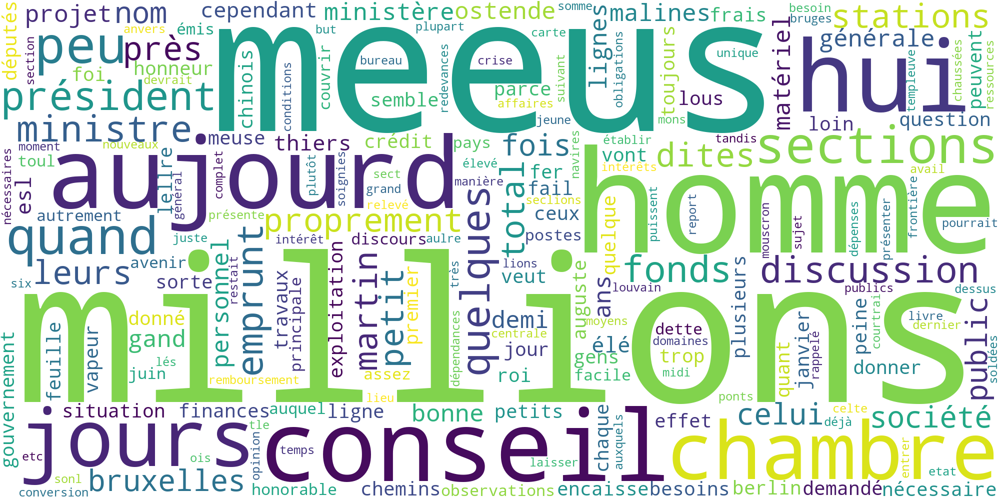

In [159]:
cloud = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(frequencies)
cloud.to_file(os.path.join(temp_path, f"{year}.png"))
Image(filename=os.path.join(temp_path, f"{year}.png"))

## Appliquer la reconnaissance d'entités nommées sur notre corpus
Reconnaissance d'entités nommées avec SpaCy

In [163]:
import nltk
from collections import defaultdict
import sys
import spacy
from spacy.lang.fr.examples import sentences
# acteur majeur de TAL
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\elaur\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [167]:
nlp = spacy.load('fr_core_news_md')

In [168]:
# Imprimer le corpus de Spacy
sentences

['Apple cherche à acheter une start-up anglaise pour 1 milliard de dollars',
 "Les voitures autonomes déplacent la responsabilité de l'assurance vers les constructeurs",
 "San Francisco envisage d'interdire les robots coursiers sur les trottoirs",
 'Londres est une grande ville du Royaume-Uni',
 'L’Italie choisit ArcelorMittal pour reprendre la plus grande aciérie d’Europe',
 "Apple lance HomePod parce qu'il se sent menacé par l'Echo d'Amazon",
 "La France ne devrait pas manquer d'électricité cet été, même en cas de canicule",
 'Nouvelles attaques de Trump contre le maire de Londres',
 'Où es-tu ?',
 'Qui est le président de la France ?',
 'Où est la capitale des États-Unis ?',
 'Quand est né Barack Obama ?']

In [169]:
# Isoler la première phrase
sent = sentences[0]
sent

'Apple cherche à acheter une start-up anglaise pour 1 milliard de dollars'

In [170]:
# Traiter la phrase avec Spacy
doc = nlp(sent)
type(doc)
doc.text

'Apple cherche à acheter une start-up anglaise pour 1 milliard de dollars'

In [171]:
# Charger le texte
n=90000
text = open("../tp4/corpus.txt", encoding="utf-8").read()[:n]

In [172]:
%%time
# Traiter le texte
doc = nlp(text)

CPU times: total: 3.5 s
Wall time: 4.86 s


In [179]:
# Compter les entités
people = defaultdict(int)
for ent in doc.ents:
    if ent.label_ == "PER" and len(ent.text) > 3:
        people[ent.text] += 1

In [180]:
# Trier et imprimer

sorted_people = sorted(people.items(), key=lambda kv: kv[1], reverse=True)

for person, freq in sorted_people[:10]:
    print(f"{person} apparait {freq} fois dans le corpus")

Friedmann apparait 7 fois dans le corpus
Louis apparait 4 fois dans le corpus
Poullet apparait 3 fois dans le corpus
P. O. B. apparait 3 fois dans le corpus
Janssen apparait 3 fois dans le corpus
Coppens apparait 3 fois dans le corpus
MM. Vandervelde apparait 2 fois dans le corpus
Wauters apparait 2 fois dans le corpus
M. Poullet apparait 2 fois dans le corpus
M. Segers apparait 2 fois dans le corpus


In [181]:
# Compter les entités
organisation = defaultdict(int)
for ent in doc.ents:
    if ent.label_ == "ORG" and len(ent.text) > 3:
        organisation[ent.text] += 1

In [183]:
# Trier et imprimer

sorted_organisation = sorted(organisation.items(), key=lambda kv: kv[1], reverse=True)

for person, freq in sorted_organisation[:10]:
    print(f"{person} apparait {freq} fois dans le corpus")

Conseil apparait 7 fois dans le corpus
Etats- Unis apparait 4 fois dans le corpus
Aveo apparait 2 fois dans le corpus
Internationale des Employés apparait 2 fois dans le corpus
BANDITS apparait 2 fois dans le corpus
Congrès apparait 2 fois dans le corpus
Sénat apparait 2 fois dans le corpus
Solvay apparait 2 fois dans le corpus
Chambre apparait 2 fois dans le corpus
Parti Communiste Beïge apparait 1 fois dans le corpus


In [184]:
# Compter les entités
location = defaultdict(int)
for ent in doc.ents:
    if ent.label_ == "LOC" and len(ent.text) > 3:
        location[ent.text] += 1

In [185]:
# Trier et imprimer

sorted_location = sorted(location.items(), key=lambda kv: kv[1], reverse=True)

for person, freq in sorted_location[:10]:
    print(f"{person} apparait {freq} fois dans le corpus")

Belgique apparait 12 fois dans le corpus
Etat apparait 10 fois dans le corpus
Etats-Unis apparait 9 fois dans le corpus
Bruxelles apparait 7 fois dans le corpus
Allemagne apparait 5 fois dans le corpus
Londres apparait 5 fois dans le corpus
Russie apparait 5 fois dans le corpus
Europe apparait 4 fois dans le corpus
Amérique apparait 3 fois dans le corpus
Vandervelde apparait 3 fois dans le corpus


# Clustering - Non supervisée 



## Charger tous les  fichiers de la décennie et en créer une liste de textes

In [66]:
data_path = "../tp4/camille_Dette_Belge_AND_bons_du_tresor_OR_bons_du_tresor/"

In [68]:
DECADE = '1925'

files = [f for f in sorted(os.listdir(txt_path)) if f"_{DECADE[:-1]}" in f]

# Vérifier si c'est bien 1925: OK
print(files[:5])

texts = [open(txt_path + f, "r", encoding="utf-8").read() for f in files]

# Pour voir à quoi ressemble le premier document: tout est OK
print(texts[0][:400])

['KB_JB1051_1925-06-03_01-00001.txt', 'KB_JB1051_1925-07-08_01-00002.txt', 'KB_JB1051_1926-04-03_01-00002.txt', 'KB_JB421_1921-03-16_01-00003.txt', 'KB_JB421_1923-02-14_01-00003.txt']
DEUXIEME ANNEE. - N. 130. 20 centimes le numéro i - liflERCRfcDI 3 JUIN 1925, DRAPEAU téléphone .: Administration-Publicité . . ... . . ... ...., 16333 * Rédaction 163.33 » Rédaction {après 19 heures) 296.89 Adressa télégraphique : DRAPOUGE-BRUXELLEÔ Compte-chèques postaux ; n" 122.595 Organe quotidien du Parti Communiste Beïge (S B I 57-5S Rue dea A»eaens, 57-59 BkO/ŒLLEL> *>, ABONNEMENTS : Belgi


## Vectoriser les documents à l'aide de TF-IDF

In [69]:
# Création d'une fonction de pré-traitement

def preprocessing(text, stem=True):
    """ Tokenize text and remove punctuation """
    text = text.translate(string.punctuation)
    tokens = word_tokenize(text)
    return tokens

# Instancier le modèle TF-IDF avec ses arguments

vectorizer = TfidfVectorizer(
    tokenizer=preprocessing,
    stop_words=stopwords.words('french'),
    max_df=0.9, #ignorer les mots apparaissant dans plus de 90% des docs
    min_df=0.1, #ignorer les mots apparaissant dans moins de 10% des docs
    lowercase=True #tout mettre en minuscules
)

# Construire la matrice de vecteurs à l'aide de la fonction `fit_transform`

tfidf_vectors = vectorizer.fit_transform(texts)

In [70]:
# Imprimer les détails de la matrice

tfidf_vectors

<89x5008 sparse matrix of type '<class 'numpy.float64'>'
	with 104750 stored elements in Compressed Sparse Row format>

## Appliquer un algorithme de clustering sur les vecteurs TF-IDF des documents

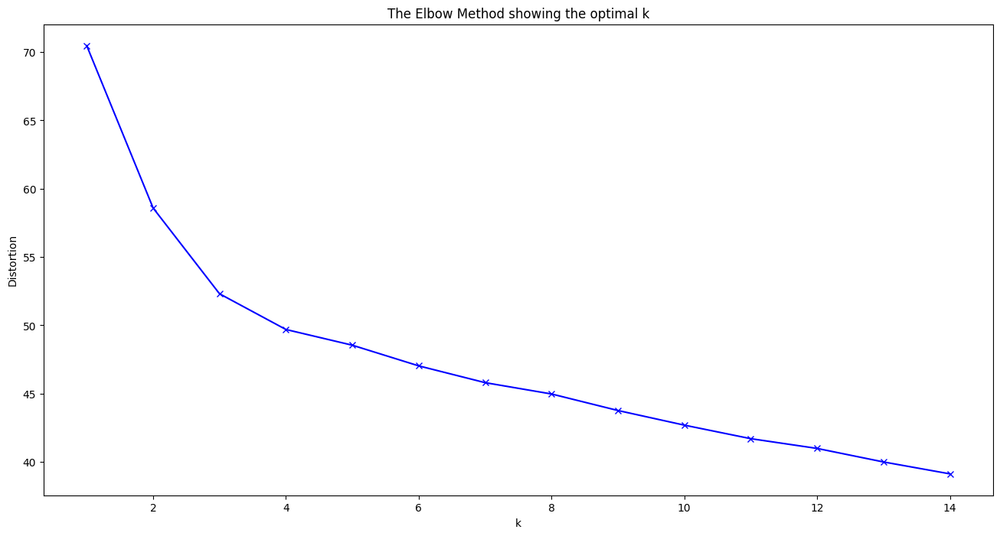

In [71]:
# Elbow method pour déterminer le nbre de clusters optimal

distortions = []
K = range(1,15) #tested:1-10, 1-15, 1-30
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(tfidf_vectors)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [72]:
# Nbre clusters

N_CLUSTERS = 3

# Instancier le modèle K-Means et ses arguments

km_model = KMeans(n_clusters=N_CLUSTERS)

# Appliquer le clustering à l'aide de la fonction fit_predict

clusters = km_model.fit_predict(tfidf_vectors)

clustering = collections.defaultdict(list)

for idx, label in enumerate(clusters):
    clustering[label].append(files[idx])

In [73]:
# Afficher le résultat du clustering (un dictionnaire)

dict(clustering)

{1: ['KB_JB1051_1925-06-03_01-00001.txt',
  'KB_JB1051_1925-07-08_01-00002.txt',
  'KB_JB1051_1926-04-03_01-00002.txt',
  'KB_JB421_1923-02-14_01-00003.txt',
  'KB_JB421_1925-12-18_01-00002.txt',
  'KB_JB421_1926-08-08_01-00004.txt',
  'KB_JB427_1921-05-20_01-00002.txt',
  'KB_JB427_1925-06-20_01-00002.txt',
  'KB_JB427_1925-08-26_01-00003.txt',
  'KB_JB427_1926-07-17_01-00003.txt',
  'KB_JB427_1926-08-09_01-00006.txt',
  'KB_JB427_1926-08-23_01-00006.txt',
  'KB_JB427_1927-09-23_01-00001.txt',
  'KB_JB427_1929-02-17_01-00001.txt',
  'KB_JB555_1921-04-10_01-00005.txt',
  'KB_JB555_1921-11-15_01-00004.txt',
  'KB_JB555_1923-02-14_01-00002.txt',
  'KB_JB555_1925-07-11_01-00001.txt',
  'KB_JB555_1925-08-23_01-00001.txt',
  'KB_JB555_1925-08-26_01-00001.txt',
  'KB_JB555_1926-04-11_01-00001.txt',
  'KB_JB555_1926-07-08_01-00001.txt',
  'KB_JB555_1926-08-08_01-00001.txt',
  'KB_JB555_1926-08-16_01-00004.txt',
  'KB_JB555_1927-06-04_01-00020.txt',
  'KB_JB567_1922-10-31_01-00001.txt',
  'KB_

## Visualiser les clusters

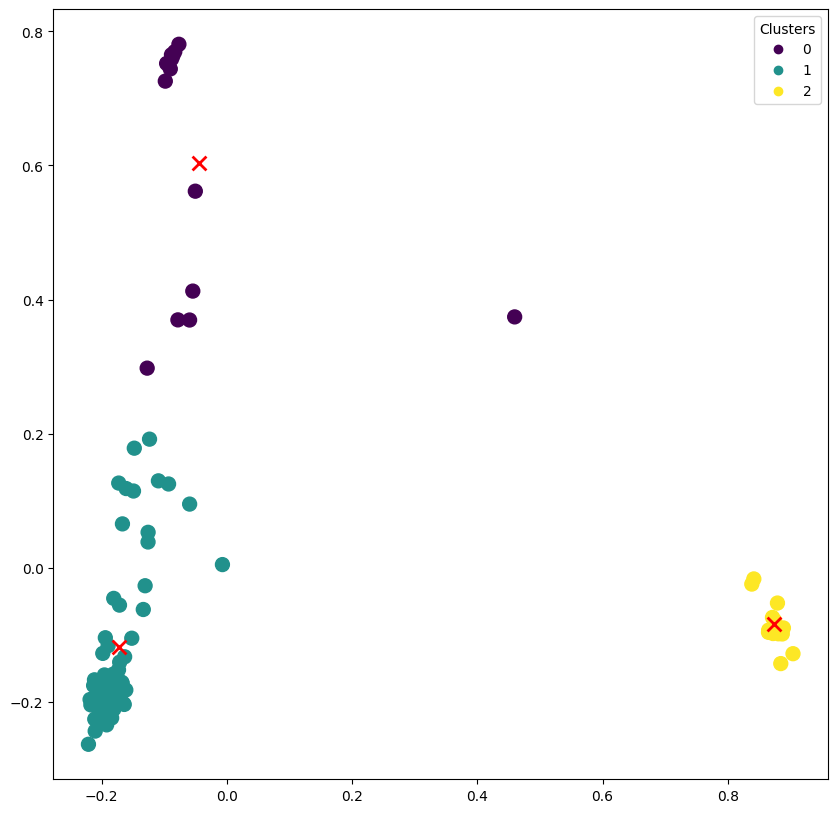

In [74]:
# Réduire les vecteurs à 2 dimensions

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(tfidf_vectors.toarray())

# Générer le graphe

x_axis = reduced_vectors[:, 0]
y_axis = reduced_vectors[:, 1]

plt.figure(figsize=(10,10))
scatter = plt.scatter(x_axis, y_axis, s=100, c=clusters)

## Ajouter les centroïdes
centroids = pca.transform(km_model.cluster_centers_)
plt.scatter(centroids[:, 0], centroids[:, 1],  marker = "x", s=100, linewidths = 2, color='red')

## Ajouter la légende
plt.legend(handles=scatter.legend_elements()[0], labels=set(clusters), title="Clusters")

## Explorer les clusters

In [75]:
# Créer des fichiers tmp avec les textes des clusters

for key in clustering.keys():
    
    tmp_content_list = []

    for txt in clustering[key]:
        
        with open(os.path.join(txt_path, txt), 'r', encoding="utf-8") as f:
            tmp_content_list.append(f.read())
        
    with open(os.path.join(temp_path, f'{DECADE}s_cluster_{key}.txt'), 'w', encoding="utf-8") as f:
        f.write(' '.join(tmp_content_list))   

### Autour des fichiers

In [76]:
# Regarder le nombre de documents par cluster

for key in clustering.keys():
    print(f"Nombre de documents dans le cluster {key} : {len(clustering[key])}")

Nombre de documents dans le cluster 1 : 62
Nombre de documents dans le cluster 0 : 14
Nombre de documents dans le cluster 2 : 13


Cluster n° 1, Nbre doc : 62, Counter({'1926': 25, '1925': 13, '1927': 8, '1923': 5, '1921': 4, '1051': 3, '1922': 2, '1929': 1, '1924': 1})


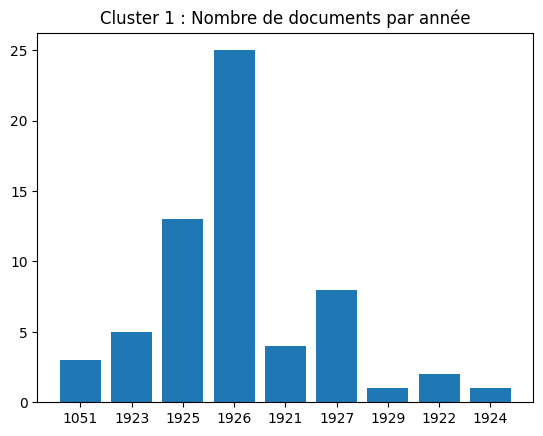

Cluster n° 0, Nbre doc : 14, Counter({'1927': 9, '1921': 2, '1926': 1, '1925': 1, '1922': 1})


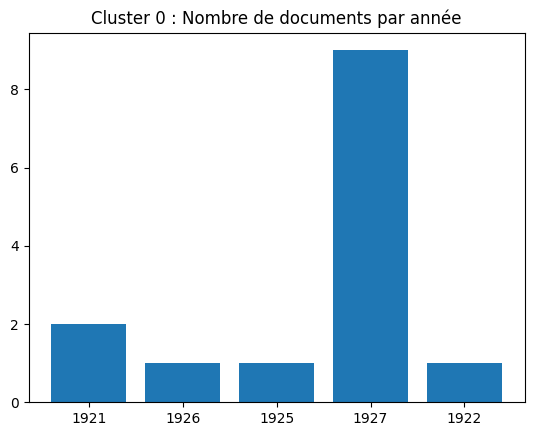

Cluster n° 2, Nbre doc : 13, Counter({'1927': 8, '1921': 2, '1924': 1, '1928': 1, '1929': 1})


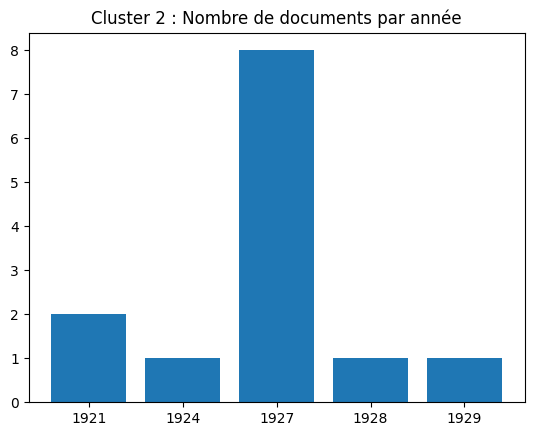

In [77]:
# Regarder la distribution des clusters selon les années

# Fonction basée autour d'une regex pour détecter l'année dans un nom de fichier
def get_year(filename):
    year = (re.search("([0-9]{4})", filename)).group()
    return year

# Création d'une liste de listes pour stocker les années pour chaque cluster
years_per_cluster = []
for key in clustering.keys():
    years_per_cluster.append([])

# Double boucle pour ajouter l'année pour chaque cluster
for key in clustering.keys():
    for i in clustering[key]:
        years_per_cluster[key].append(get_year(i))
    
    # testing
    # print(key, len(years_per_cluster[key]))

# testing
# print(years_per_cluster[0].count('1932'))

# Créer des graphes pour chaque cluster, en utilisant Counter pour compter le nbre de fichiers par années dans la liste de listes
for key in clustering.keys():
    tmp_counter = Counter(years_per_cluster[key])
    print(f"Cluster n° {key},", f"Nbre doc : {len(clustering[key])},", tmp_counter)

    plt.bar(tmp_counter.keys(), tmp_counter.values())
    plt.title(f"Cluster {key} : Nombre de documents par année")
    plt.show()

### Keywords

4 cellules distinctes et non une boucle _for_ comme ci-dessus et ci-dessous car, pour une raison étrange, la boucle tourne "dans le vide" tandis que les cellules indépendantes donnent un résultat (après un long moment pour celle qui traite le plus gros cluster).

In [78]:
# Regarder les mots-clés de chaque cluster

# Instantier l'extracteur de mots clés en fr + les 10 premiers
kw_extractor = yake.KeywordExtractor(lan="fr", top=10)

# Récupérer le texte sauvegardé ci-dessus
text = open(os.path.join(temp_path, f'{DECADE}s_cluster_0.txt'), 'r', encoding="utf-8").read()

# Extraire les mots clés de ce texte
keywords = kw_extractor.extract_keywords(text)
print(f"Keywords, cluster n° 0 : {keywords}")

# Ne garder que les bigrammes / trigrammes
kept_bigrams = []
kept_trigrams = []
for kw, score in keywords:
    words = kw.split()
    if len(words) == 2: # si c'est un bigramme
        kept_bigrams.append(kw)
    elif len(words) == 3: # si c'est un trigramme
        kept_trigrams.append(kw)

print(f"Bigrammes récurrents, cluster n° 0 : {kept_bigrams}")
print(f"Trigrammes récurrents, cluster n° 0 : {kept_trigrams}")
print("")

Keywords, cluster n° 0 : [('Immobilières Banque Belge', 0.00023013553296732228), ('Congo', 0.00025444704572164396), ('Nord Charleroi Nord', 0.0002652949971387784), ('Congo Belge', 0.00028094033595749715), ('COURS COURS COURS', 0.00029242635594453045), ('Bruxelles', 0.0003312651290933593), ('Nord', 0.00034585918349944736), ('BANQUE CHAUDOIR Société', 0.0003780764340957617), ('Liège', 0.0004035941720944233), ('Banque Belge', 0.0004184696503939163)]
Bigrammes récurrents, cluster n° 0 : ['Congo Belge', 'Banque Belge']
Trigrammes récurrents, cluster n° 0 : ['Immobilières Banque Belge', 'Nord Charleroi Nord', 'COURS COURS COURS', 'BANQUE CHAUDOIR Société']



In [79]:
# Regarder les mots-clés de chaque cluster et voir s'il y a des éléments intéressants qui en ressortent 
# (pourquoi pas leur attribuer un "thème")

# Instantier l'extracteur de mots clés en fr + les 10 premiers
kw_extractor = yake.KeywordExtractor(lan="fr", top=10)

# Récupérer le texte sauvegardé ci-dessus
text = open(os.path.join(temp_path, f'{DECADE}s_cluster_1.txt'), 'r', encoding="utf-8").read()

# Extraire les mots clés de ce texte
keywords = kw_extractor.extract_keywords(text)
print(f"Keywords, cluster n° 1 : {keywords}")

# Ne garder que les bigrammes / trigrammes
kept_bigrams = []
kept_trigrams = []
for kw, score in keywords:
    words = kw.split()
    if len(words) == 2: # si c'est un bigramme
        kept_bigrams.append(kw)
    elif len(words) == 3: # si c'est un trigramme
        kept_trigrams.append(kw)

print(f"Bigrammes récurrents, cluster n° 1 : {kept_bigrams}")
print(f"Trigrammes récurrents, cluster n° 1 : {kept_trigrams}")
print("")

Keywords, cluster n° 1 : [('Banque Nationale', 3.9513073470561665e-05), ('Société Nationale', 4.102336739391911e-05), ('dette belge', 4.504868679711939e-05), ('Bruxelles', 6.307463675186587e-05), ('Belgique', 7.570841043170643e-05), ("c'est", 9.613133290332054e-05), ("qu'il", 9.742770368320478e-05), ('Fer Belges', 0.00010529044233381238), ('gouvernement', 0.00010954091816020597), ('CHEMINS DE FER', 0.0001162288951694714)]
Bigrammes récurrents, cluster n° 1 : ['Banque Nationale', 'Société Nationale', 'dette belge', 'Fer Belges']
Trigrammes récurrents, cluster n° 1 : ['CHEMINS DE FER']



In [80]:
# Regarder les mots-clés de chaque cluster et voir s'il y a des éléments intéressants qui en ressortent 
# (pourquoi pas leur attribuer un "thème")

# Instantier l'extracteur de mots clés en fr + les 10 premiers
kw_extractor = yake.KeywordExtractor(lan="fr", top=10)

# Récupérer le texte sauvegardé ci-dessus
text = open(os.path.join(temp_path, f'{DECADE}s_cluster_2.txt'), 'r', encoding="utf-8").read()

# Extraire les mots clés de ce texte
keywords = kw_extractor.extract_keywords(text)
print(f"Keywords, cluster n° 2 : {keywords}")

# Ne garder que les bigrammes / trigrammes
kept_bigrams = []
kept_trigrams = []
for kw, score in keywords:
    words = kw.split()
    if len(words) == 2: # si c'est un bigramme
        kept_bigrams.append(kw)
    elif len(words) == 3: # si c'est un trigramme
        kept_trigrams.append(kw)

print(f"Bigrammes récurrents, cluster n° 2 : {kept_bigrams}")
print(f"Trigrammes récurrents, cluster n° 2 : {kept_trigrams}")
print("")

Keywords, cluster n° 2 : [('cours', 0.000299594453478975), ('marché', 0.00048376178480868205), ('Bruxelles', 0.00048659723090084057), ('Société', 0.0005429531654294889), ('BOURSE BRUXELLES BRUXELLES', 0.0007728659151344491), ('prix', 0.0008116824850446161), ('Société Générale', 0.000868119930365302), ('capital', 0.0008914975142407972), ('francs', 0.0009041928981231009), ('rue', 0.0009516335715437094)]
Bigrammes récurrents, cluster n° 2 : ['Société Générale']
Trigrammes récurrents, cluster n° 2 : ['BOURSE BRUXELLES BRUXELLES']



### Nuage de mots

In [81]:
# Stopwords
sw = stopwords.words("french")
sw += [
    # Coquilles OCR pas enlevées par fonction de nettoyage
    "brux", "belg", "cond", "intér","télép", "téléph", "parf", "référ", "culs", 
    "serv", "trav", "pers", "conf", "sach", "conn", "cuis", "chauf", "chauff", "journ", 
    "cherc", "flam", "exlg", "ouvr", "prop", "meub", "domest", "chaus", "préf", "angl", 
    "inst", "repr", "jard", "chamb", "terr", "franç", "élect", "conv", "rapp", "centr", 
    "atel", "plac", "appartem", "coch", "tranq", "pled", "compr", "schaerb", "condlt", 
    "adres", "aujourd", "couch", "compt", "pens", "exig", "conc", "comp", "situât", "merc",
    "gara", "couch", "charlerol",
    # Mots (quasiment) vides de sens
    "les", "plus", "cette", "fait", "faire", "être", "deux", "comme", "dont", 
    "tout", "ils", "bien", "sans", "peut", "tous", "après", "ainsi", "donc", "cet", 
    "sous", "celle", "entre", "encore", "toutes", "toute", "pendant", "moins", 
    "dire", "voir", "cela", "non", "faut", "trois", "quatre", "cinq", "quart",
     "demi", "aussi", "dit", "avoir", "doit", "contre", "depuis", "autres", 
     "van", "het", "autre", "jusqu", "très", "trop", "chez", "près", "toutes",
      "leurs", "avant", "suite", "rien", "quelques", "puis", "alors", "quand",
       "ceux", "elles", "déjà", "celui", "devant", "toujours", "outre", "tant", 
       "mieux", "assez", "beaucoup", "plusieurs", "quelque", "quelques", "vers",
        "ensuite", "voici", "notamment", "chaque", "laquelle", "parmi",
    # Mots pas pertinents dans le contexte du journal
    "rossel", "agence", "nord", "midi", "royale", "ville", "avenue", "place",
     "boulevard", "chaussée", "saint", "octobre", "mardi", "août", "dimanche",
      "septembre", "lundi", "décembre", "janvier", "juin", "avril", "mercredi",
       "samedi", "novembre", "jeudi", "vendredi"]
sw = set(sw)

# Fonction de nettoyage

def clean_text(key, folder=None):
    if folder is None:
        input_path = f"{DECADE}s_cluster_{key}.txt"
        output_path = f"{DECADE}s_cluster_{key}_clean.txt"
    else:
        input_path = f"{folder}{DECADE}s_cluster_{key}.txt"
        output_path = f"{folder}{DECADE}s_cluster_{key}_clean.txt"
    output = open(output_path, "w", encoding='utf-8')
    with open(input_path, encoding='utf-8') as f:
        text = f.read()
        words = nltk.wordpunct_tokenize(text)
        kept = [w.lower() for w in words if len(w) > 3 and w.isalpha() and w.lower() not in sw]
        kept_string = " ".join(kept)
        output.write(kept_string)
    return f'Output has been written in {output_path}!'

In [82]:
# Appliquer la fonction et vérifier les résultats

for key in clustering.keys():

    clean_text(key, folder=temp_path)

    with open(os.path.join(temp_path, f'{DECADE}s_cluster_{key}_clean.txt'), 'r', encoding="utf-8") as f:
        after = f.read()

    # Calculer les mots les plus fréquents et afficher les résultats

    frequencies = Counter(after.split())

    print(f"Cluster n° {key} :", frequencies.most_common(200))
    print("")

    cloud = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(frequencies)
    cloud.to_file(os.path.join(temp_path, f"{DECADE}s_cluster_{key}.png"))

Cluster n° 1 : [('francs', 507), ('gouvernement', 500), ('bruxelles', 468), ('millions', 447), ('belgique', 399), ('dette', 345), ('belge', 334), ('etat', 328), ('ministre', 321), ('actions', 298), ('heures', 284), ('pays', 278), ('conseil', 271), ('société', 270), ('france', 259), ('président', 257), ('guerre', 253), ('bons', 251), ('mois', 248), ('prix', 246), ('nationale', 244), ('lieu', 242), ('chambre', 241), ('grand', 239), ('jour', 230), ('banque', 228), ('général', 226), ('cours', 226), ('droit', 202), ('grande', 201), ('accord', 201), ('belges', 199), ('temps', 199), ('privilégiées', 199), ('paris', 197), ('question', 188), ('point', 186), ('moment', 184), ('compte', 183), ('part', 182), ('matin', 181), ('commission', 177), ('londres', 177), ('politique', 176), ('intérêt', 175), ('situation', 174), ('français', 174), ('ordre', 169), ('année', 167), ('vient', 165), ('chemins', 162), ('etats', 161), ('capital', 160), ('travail', 160), ('unis', 159), ('projet', 159), ('trésor', 1

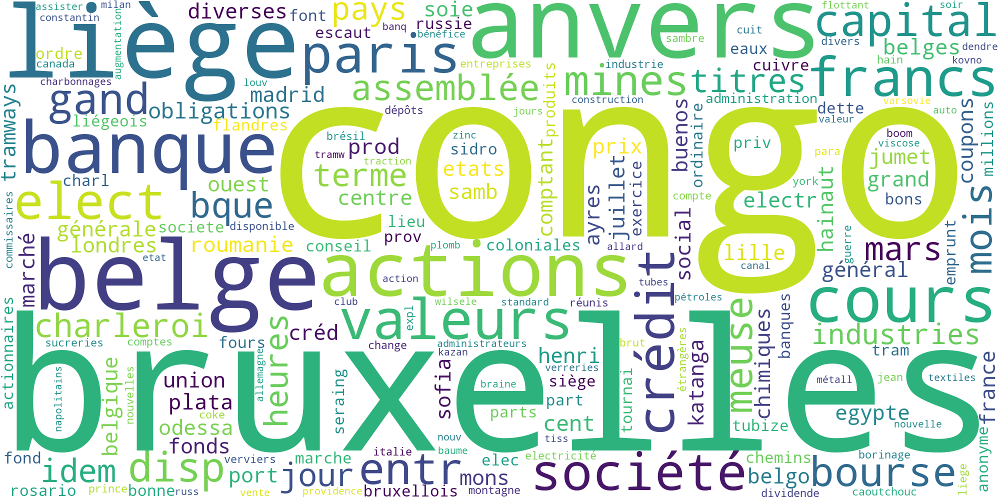

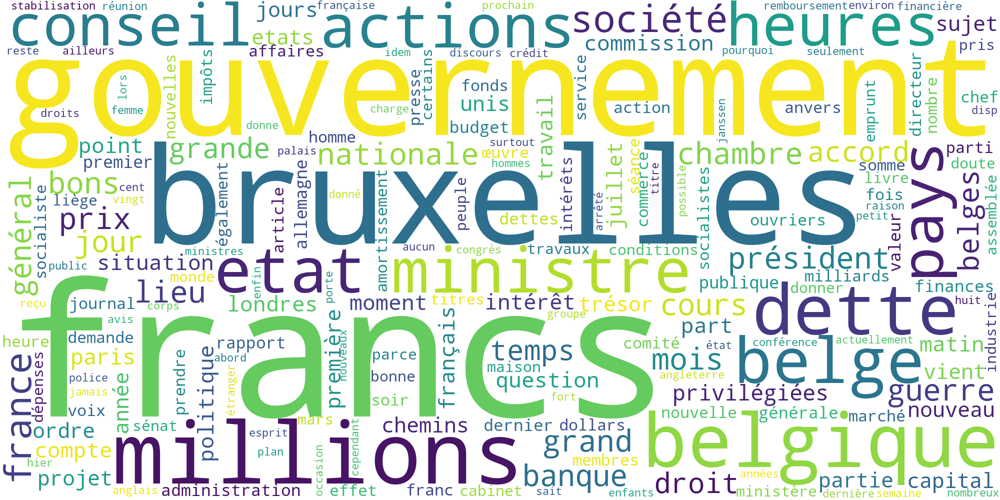

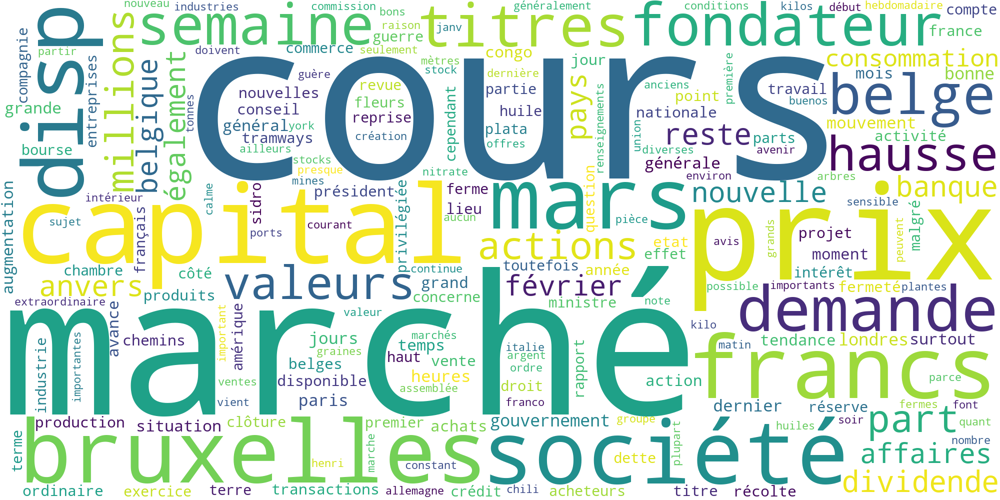

In [84]:
# Solution ad hoc car il semble impossible d'intégrer facilement plusieurs images dans une même cellule d'un jupyer notebook

w = Image(filename=f'{temp_path}1925s_cluster_0.png')
x = Image(filename=f'{temp_path}1925s_cluster_1.png') 
y = Image(filename=f'{temp_path}1925s_cluster_2.png') 
display(w, x, y)

# Word Embbeding avec Word2vec  Non supervise

In [85]:
# config
temp_path = '../tp4/corpus/'
if not os.path.exists(temp_path):
    os.mkdir(temp_path)

### Chargement et traitement des phrases du corpus

In [86]:
# Création d'un objet qui streame les lignes d'un fichier pour économiser de la RAM

class MySentences(object):
    """Tokenize and Lemmatize sentences""" # Permet de tokenizer des "doubles" mots, par ex "premier" + 
    # ministre" va être considéré comme un token "premier ministre"
    def __init__(self, filename):
        self.filename = filename

    def __iter__(self):
        for line in open(self.filename, encoding='utf-8', errors="backslashreplace"):
            yield [unidecode(w.lower()) for w in wordpunct_tokenize(line)]

infile = f"../tp4/corpus.txt"
sentences = MySentences(infile)

#### Détection des bigrams

In [87]:
# Création de l'objet 'phrases' = "dictionnaire d'expressions multi-mots associées à un score", 
# dont les clés correspondent aux termes du corpus

bigram_phrases = Phrases(sentences)

In [89]:
# Conversion des objets 'phrases' en objet 'phraser' = version light du 'phrases' ->
# convertit certains unigrams en bigrams s'ils sont pertinents

bigram_phraser = Phraser(phrases_model=bigram_phrases)

# Sauvegarder l'objet Phraser des bigrammes

with open(f"{temp_path}bigrams.p", 'wb') as f:
    pickle.dump(bigram_phraser, f)

#### Détection des trigrams

In [90]:
# Ouvrir l'objet Phraser des bigrammes

bigram_phraser = pickle.load(open(f"{temp_path}bigrams.p", "rb"))

In [91]:
trigram_phrases = Phrases(bigram_phraser[sentences])

In [92]:
# Conversion en objet Phraser et sauvegarde du Phraser des trigrammes

trigram_phraser = Phraser(phrases_model=trigram_phrases)

with open(f"{temp_path}trigrams.p", 'wb') as f:
    pickle.dump(trigram_phraser, f)

#### Création d'un corpus d'unigrams, bigrams, trigrams

In [93]:
bigram_phraser = pickle.load(open(f"{temp_path}bigrams.p", "rb"))
trigram_phraser = pickle.load(open(f"{temp_path}trigrams.p", "rb"))

In [94]:
corpus = list(trigram_phraser[bigram_phraser[sentences]])

# Imprimer une liste de n-grammes, qu'on répère car ils sont séparés par des _

print(corpus[:10])

[['deuxieme', 'annee', '.', '-', 'n', '.', '130', '.', '20_centimes', 'le_numero', 'i', '-', 'liflercrfcdi', '3', 'juin_1925', ',', 'drapeau', 'telephone', '.:', 'administration', '-', 'publicite', '.', '.', '...', '.', '.', '...', '....,', '16333', '*', 'redaction', '163', '.', '33', '>>', 'redaction', '{', 'apres', '19', 'heures', ')', '296', '.', '89', 'adressa', 'telegraphique', ':', 'drapouge', '-', 'bruxelleo', 'compte', '-', 'cheques_postaux', ';', 'n', '"', '122', '.', '595', 'organe', 'quotidien', 'du_parti', 'communiste', 'beige', '(', 's', 'b', 'i', '57', '-', '5s', 'rue_dea', 'a', '>>', 'eaens', ',', '57', '-', '59', 'bko', '/', 'oellel', '>', '*>,', 'abonnements', ':', 'belgique', ',', '30_septembre', '31', 'decent', '>', 'etranger', '.', '1', 'an', '.', 'i', 't', "'", 'abonne_dans', 'tous_tes', ',', 'bureaux', 'de', 'punis', '.', 'les', 'dettes_belges', 'envers_les', 'etats_-_unis', 'vers', "l_'_inflation", 'et', 'la_main', '-', 'mise', 'americaine', 'sur', "l_'_industrie

### Entraînement d'un modèle word2vec sur ce corpus

In [99]:
# Charger la liste des n-grams
# disabled cause not working

# corpus = pickle.load(open("ngrams_list.p", "rb"))

In [100]:
%%time
model = Word2Vec( # default parameters
    corpus, # On passe le corpus de ngrams que nous venons de créer
    vector_size=32, # Le nombre de dimensions dans lesquelles le contexte des mots devra être réduit, aka. vector_size
    window=7, # La taille du "contexte" (avant/après le mot)
    min_count=5, # On ignore les mots qui n'apparaissent pas au moins 'min_count' fois dans le corpus
    workers=4, # Permet de paralléliser l'entraînement du modèle en plusieurs threads
    epochs=5 # Nombre d'itérations du réseau de neurones sur le jeu de données pour ajuster 
    #les paramètres avec la descente de gradient, aka. epochs
)

# Sauver le modèle dans un fichier
outfile = f"{temp_path}model_window7_mincount5.model"
model.save(outfile)

CPU times: total: 1.2 s
Wall time: 2.2 s


In [101]:
%%time
model = Word2Vec( # even higher min_count and window
    corpus, # On passe le corpus de ngrams que nous venons de créer
    vector_size=32, # Le nombre de dimensions dans lesquelles le contexte des mots devra être réduit, aka. vector_size
    window=6, # La taille du "contexte" (avant/après le mot)
    min_count=10, # On ignore les mots qui n'apparaissent pas au moins 'min_count' fois dans le corpus
    workers=4, # Permet de paralléliser l'entraînement du modèle en plusieurs threads
    epochs=5 # Nombre d'itérations du réseau de neurones sur le jeu de données pour ajuster les 
    # paramètres avec la descente de gradient, aka. epochs
)

# Sauver le modèle dans un fichier
outfile = f"{temp_path}model_window6_mincount10.model"
model.save(outfile)

CPU times: total: 641 ms
Wall time: 1.47 s


### Exploration des modèles

Comme proposé dans les consignes du TP, j'ai créé plusieurs modèles en jouant sur les paramètres 'min_count' et 'window'. Je détaille les différences entre ces modèles dans le rapport.

In [103]:
# Charger les modèles en mémoire dans une liste

models = []

models.append(Word2Vec.load(f"{temp_path}model_window7_mincount5.model"))
models.append(Word2Vec.load(f"{temp_path}model_window6_mincount10.model"))
nb_models = len(models)

In [104]:
# Fonction "similarity" : Calculer la similarité entre deux termes

first_term = ["journaliste", "chaud", "appartement"] # première liste des mots
second_term = ["presse", "froid", "loue"] # seconde liste de mots
nb_similarity_examples = len(first_term)

for i in range (nb_similarity_examples) : # pour chaque exemple
    for j in range (nb_models): # pour chaque modèle
        print(f"'{first_term[i]}' et '{second_term[i]}' (modèle {j}) : {models[j].wv.similarity(first_term[i], second_term[i])}") 
        # imprimer la similarité entre les deux mots issus des deux listes
    print("")

'journaliste' et 'presse' (modèle 0) : 0.5918155908584595
'journaliste' et 'presse' (modèle 1) : 0.7806562185287476

'chaud' et 'froid' (modèle 0) : 0.06610332429409027
'chaud' et 'froid' (modèle 1) : 0.044703200459480286

'appartement' et 'loue' (modèle 0) : -0.06720879673957825
'appartement' et 'loue' (modèle 1) : -0.07393938302993774



In [1]:
# Fonction "most_similar" : Chercher les mots les plus proches d'un terme donné

most_similar_word = ["bruxelles", "jardin", "habiter"] # liste de mots
nb_most_similar_examples = len(most_similar_word)

for i in range (nb_most_similar_examples) : # pour chaque exemple
    for j in range (nb_models): # pour chaque modèle
        print(f"Mots les plus semblables à '{most_similar_word[i]}' (modèle {j}) :", models[j].wv.most_similar(most_similar_word[i], topn=10)) # imprimer les mots les plus sembables au mot sélectionné
    print("")

NameError: name 'nb_models' is not defined